# Main Capstone Project Notebook

# Traitements des accidents corporels dans les hauts de seine

quel prétraitement des données?
Labellisation des moments de la journées (nuit, heuresde pointes, journée)
intervenants, pietons, cyclistes, motos ...
tués, blessés graves
clusterisation 

## Table of Contents

<div class="alert alert-block alert-info" style="margin-top: 20px">

1. [Exploring Datasets with *p*andas](#0)<br>
2. [Downloading and Prepping Data](#2)<br>
3. [Introduction to Folium](#4) <br>
4. [Map with Markers](#6) <br>
5. [Choropleth Maps](#8) <br>
</div>
<hr>

In [1]:
import pandas as pd
import numpy as np
import requests

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

import matplotlib as mpl
import matplotlib.pyplot as plt


%matplotlib inline 


import folium
from folium import plugins

from geopy.geocoders import Nominatim


In [2]:
df_accident = pd.read_csv('accidents-corporels-de-la-circulation-routiere.csv',sep=';',encoding='utf-8')
df_accident.head()

,geo_point_2d,ID_PV,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,TYPE_COLLI,...,NB_TC_BH,NB_TC_T,CAT_VE5,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,geo_shape
0,"48.8875074156,2.2330050853",Sécurité publique 0092062 00930,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2330050853..."
1,"48.8796764303,2.2360162598",Sécurité publique 0092062 00978,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2360162597..."
2,"48.8807760247,2.23779962225",Sécurité publique 0092062 01309,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2377996222..."
3,"48.8864552637,2.25219630828",Sécurité publique 0092062 01353,2008-06-18,16:25,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2521963082..."
4,"48.8782634548,2.24267820399",Sécurité publique 0092062 01365,2008-06-20,22:20,92062,Puteaux,Intersection en X,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2426782039..."


In [3]:
from datetime import datetime

df_accident['YEAR'] = df_accident['DATE_'].map(lambda s: datetime.strptime(s, '%Y-%m-%d').year)
df_accident['YEAR'].apply(lambda v: int(v))
df_accident['COMMUNE'].replace('Ville-d\'Avray','Ville d\'Avray',inplace=True)

df_accident.head()

,geo_point_2d,ID_PV,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,TYPE_COLLI,...,NB_TC_T,CAT_VE5,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,geo_shape,YEAR
0,"48.8875074156,2.2330050853",Sécurité publique 0092062 00930,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2330050853...",2008
1,"48.8796764303,2.2360162598",Sécurité publique 0092062 00978,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2360162597...",2008
2,"48.8807760247,2.23779962225",Sécurité publique 0092062 01309,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2377996222...",2008
3,"48.8864552637,2.25219630828",Sécurité publique 0092062 01353,2008-06-18,16:25,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2521963082...",2008
4,"48.8782634548,2.24267820399",Sécurité publique 0092062 01365,2008-06-20,22:20,92062,Puteaux,Intersection en X,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2426782039...",2008


Read the latitude/longitude of each accident

In [4]:
#number of na values by column
res = df_accident.isna().sum()
print(res)

geo_point_2d        0
ID_PV            2740
DATE_               0
HEURE               0
CODE_INSEE          0
                ...  
NB_T_VE5        31679
NB_BH_VE5       31679
NB_BNH_VE5      31679
geo_shape           0
YEAR                0
Length: 140, dtype: int64


In [5]:

def getCoords(s):
    tokens = str.split(s,',')
    lat = float(tokens[0])
    lng = float(tokens[1])
    return lat,lng


lats = []
lngs=[]
#df_accident['Latitude'],df_accident['Longitude'] 
res1= df_accident['geo_point_2d'].map(getCoords)
for tpl in res1:
    lats.append(tpl[0])
    lngs.append(tpl[1])


df_accident['Latitude']=lats
df_accident['Longitude']=lngs
df_accident.head()


,geo_point_2d,ID_PV,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,TYPE_COLLI,...,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,geo_shape,YEAR,Latitude,Longitude
0,"48.8875074156,2.2330050853",Sécurité publique 0092062 00930,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2330050853...",2008,48.887507,2.233005
1,"48.8796764303,2.2360162598",Sécurité publique 0092062 00978,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2360162597...",2008,48.879676,2.236016
2,"48.8807760247,2.23779962225",Sécurité publique 0092062 01309,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2377996222...",2008,48.880776,2.237800
3,"48.8864552637,2.25219630828",Sécurité publique 0092062 01353,2008-06-18,16:25,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2521963082...",2008,48.886455,2.252196
4,"48.8782634548,2.24267820399",Sécurité publique 0092062 01365,2008-06-20,22:20,92062,Puteaux,Intersection en X,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,...,NaN,NaN,NaN,NaN,NaN,NaN,"{""type"": ""Point"", ""coordinates"": [2.2426782039...",2008,48.878263,2.242678


In [6]:
df_accident.columns

Index(['geo_point_2d', 'ID_PV', 'DATE_', 'HEURE', 'CODE_INSEE', 'COMMUNE',
       'LIEU', 'LUMINOSITE', 'COND_ATMOS', 'TYPE_COLLI',
       ...
       'ROUTE_VE5', 'SENS_VE5', 'MAN_VE5', 'NB_T_VE5', 'NB_BH_VE5',
       'NB_BNH_VE5', 'geo_shape', 'YEAR', 'Latitude', 'Longitude'],
      dtype='object', length=142)

In [7]:

# i drop the useless columns
df_accident.drop(['geo_point_2d','geo_shape'],axis=1,inplace=True)

df_accident.head()

,ID_PV,DATE_,HEURE,CODE_INSEE,COMMUNE,LIEU,LUMINOSITE,COND_ATMOS,TYPE_COLLI,ADRESSE,...,CAT_VE5,ROUTE_VE5,SENS_VE5,MAN_VE5,NB_T_VE5,NB_BH_VE5,NB_BNH_VE5,YEAR,Latitude,Longitude
0,Sécurité publique 0092062 00930,2008-04-15,15:00,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,GAULLE / BERTHELOT,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2008,48.887507,2.233005
1,Sécurité publique 0092062 00978,2008-04-30,18:20,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,"4, R DES BAS ROGERS",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2008,48.879676,2.236016
2,Sécurité publique 0092062 01309,2008-06-14,20:45,92062,Puteaux,Intersection en X,Plein jour,Normales,Collision par le côté,JAURES / WALLACE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2008,48.880776,2.237800
3,Sécurité publique 0092062 01353,2008-06-18,16:25,92062,Puteaux,Hors intersection,Plein jour,Normales,Sans collision,QU DE DION BOUTON,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2008,48.886455,2.252196
4,Sécurité publique 0092062 01365,2008-06-20,22:20,92062,Puteaux,Intersection en X,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,BOUTON / PT PUTEAUX,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2008,48.878263,2.242678


In [8]:
address = 'Nanterre, France'

geolocator = Nominatim(user_agent="Coursra_FinalAssignment")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

map_hs = folium.Map(location=[latitude, longitude], zoom_start=15)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(map_hs)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(df_accident['Latitude'], df_accident['Longitude'], df_accident['TYPE_COLLI']):
    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(incidents)

map_hs



I simplify the datas

# Number of accident per Year


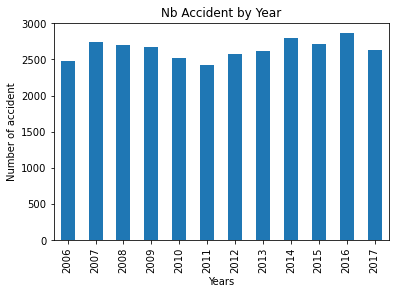

In [113]:
#plot number of accident by year
# byYears.plot(kind='bar')
df_accident['YEAR'].value_counts().sort_index().plot.bar()

plt.title('Nb Accident by Year')
plt.ylabel('Number of accident')
plt.xlabel('Years')

plt.show() # need this line to show the updates made to the figure


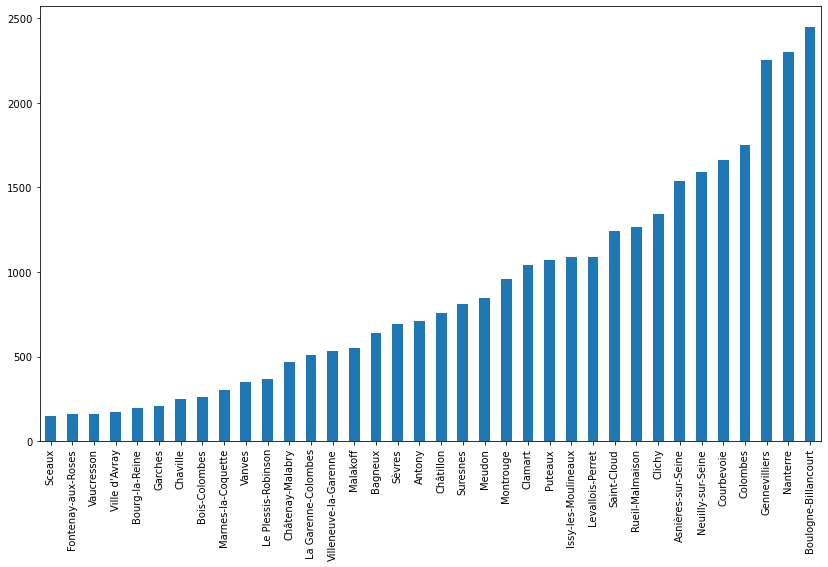

In [45]:
#plot by town and by year
towns = df_accident['COMMUNE'].unique()

df_town=pd.DataFrame()
for town in towns:
    df_town[town] = df_accident[df_accident['COMMUNE']==town]['YEAR'].value_counts().sort_index()

#compute the total number of accident by town
tot = df_town.sum().sort_values()
tot.plot.bar(figsize=(14, 8))

# df_town.head()
# df_town.index = df_town.index.map(int) # let's change the index values of df_CI to type integer for plotting
# df_town.plot(kind='bar')

# plt.title('Nb of accident by town')
# plt.ylabel('Number of Accident')
# plt.xlabel('Years')

,Puteaux,Neuilly-sur-Seine,Rueil-Malmaison,Saint-Cloud,Garches,Vaucresson,Ville d'Avray,Sèvres,Chaville,Marnes-la-Coquette,...,La Garenne-Colombes,Issy-les-Moulineaux,Châtillon,Montrouge,Bois-Colombes,Levallois-Perret,Bourg-la-Reine,Fontenay-aux-Roses,Sceaux,Bagneux
2006,73,105,112,97,10,13,22,46,29,19,...,27,97,76,76,22,102,21,15,16,53
2007,93,141,119,95,15,16,13,53,22,16,...,42,86,61,97,20,100,22,23,17,65
2008,112,129,89,95,12,17,18,59,20,20,...,46,98,68,72,23,99,18,19,11,56
2009,99,152,117,122,19,11,14,61,16,18,...,36,99,65,82,24,95,24,19,14,63
2010,90,149,84,94,20,16,18,57,22,24,...,46,87,49,91,23,88,19,13,12,54


[2008 2008 2008 ... 2017 2016 2017]


154

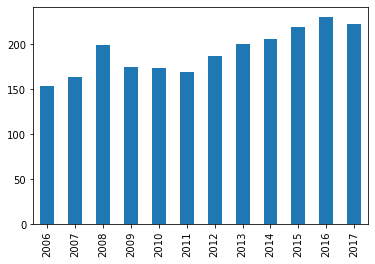

In [31]:
grp = df_accident[df_accident['COMMUNE']=='Nanterre']['YEAR']
grp.value_counts().sort_index().plot.bar()

print(grp.values)

grp.index[2]


# Clustering

## preprocessing of the data

Add column to identifiy 

In [13]:
df_light1 = df_accident[['DATE_','ID_PV','LUMINOSITE','COND_ATMOS','TYPE_COLLI','CAT_ROUTE1','TYPE_ACCI','NB_USAGER','NB_VEH','NB_PIE','NB_VEL','NB_CYC','NB_MOT','NB_VL','NB_PL','NB_TC']]

df_cluster1.head()

,ID_PV,LUMINOSITE,COND_ATMOS,TYPE_COLLI,CAT_ROUTE1,TYPE_ACCI,NB_USAGER,NB_VEH,NB_PIE,NB_VEL,NB_CYC,NB_MOT,NB_VL,NB_PL,NB_TC
0,Sécurité publique 0092062 00930,Plein jour,Normales,Collision par le côté,Route départementale,Léger,2,2,0,0,0,1,1,0,0
1,Sécurité publique 0092062 00978,Plein jour,Normales,Sans collision,Route départementale,Léger,1,1,0,0,0,1,0,0,0
2,Sécurité publique 0092062 01309,Plein jour,Normales,Collision par le côté,Voie communale,Léger,3,2,0,0,0,1,1,0,0
3,Sécurité publique 0092062 01353,Plein jour,Normales,Sans collision,Route départementale,Léger,1,1,0,0,0,0,1,0,0
4,Sécurité publique 0092062 01365,Nuit avec éclairage public allumé,Normales,Collision par l'arrière,Route départementale,Léger,2,2,0,0,0,1,1,0,0


In [15]:
# import k-means from clustering stage
from sklearn.cluster import KMeans

# set number of clusters
kclusters = 5

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(df_cluster1)

# check cluster labels generated for each row in the dataframe
kmeans.labels_

ValueError: could not convert string to float: 'Grave'